# Video Affinity

This notebook is based on the code released from [ViSiL: Fine-grained Spatio-Temporal Video Similarity Learning](https://arxiv.org/pdf/1908.07410.pdf). Please refer to the paper for more technical details.

In [ ]:
from google.colab import drive

drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Download Source

In [1]:
# Download the repo and checkpoint if necessary.
import os

GIT_REPO_PATH = '/content/drive/MyDrive/git-repos'
%cd $GIT_REPO_PATH
if not os.path.exists('%s/visil' % GIT_REPO_PATH):
  !git clone -b pytorch https://github.com/MKLab-ITI/visil
%cd "$GIT_REPO_PATH/visil"
!pip install -r requirements.txt
if not os.path.exists('%s/visil/ckpt' % GIT_REPO_PATH):
  !wget http://ndd.iti.gr/visil/ckpt.zip
  !unzip ckpt.zip
  !rm ckpt.zip

/content/drive/MyDrive/git-repos
/content/drive/MyDrive/git-repos/visil


## Construct Model

In [18]:
import random

import imageio
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import torch

%cd "$GIT_REPO_PATH/visil"
from model.visil import ViSiL
from utils import load_video

%matplotlib inline

/content/drive/MyDrive/git-repos/visil


In [3]:
# Ensure a deterministic behavior
_SEED = 42
random.seed(_SEED)
np.random.seed(_SEED)
torch.manual_seed(_SEED)
torch.cuda.manual_seed(_SEED)
torch.cuda.manual_seed_all(_SEED)

# When running on the CuDNN backend, two further options must be set
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [29]:
model = ViSiL(pretrained=True)
if device.type == 'cuda':
  model = model.to('cuda')
model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ViSiL(
  (cnn): Feature_Extractor(
    (normalizer): VideoNormalizer()
    (cnn): ResNet(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=T

## Download Videos

In [6]:
# Download repo if necessary
%cd $GIT_REPO_PATH
if not os.path.exists("%s/FIVR-200K" % GIT_REPO_PATH):
  !git clone https://github.com/MKLab-ITI/FIVR-200K.git
%cd FIVR-200K
!pip install -r requirements.txt

/content/drive/MyDrive/git-repos
/content/drive/MyDrive/git-repos/FIVR-200K


In [ ]:
!python3 -m pip install -U yt-dlp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.4/194.4 kB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 24.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 31.7 MB/s eta 0:00:00


In [7]:
video_id_path = '%s/FIVR-200K/dataset/youtube_ids_medium.txt' % GIT_REPO_PATH
video_path = '/content/sample_data/videos'
if not os.path.exists(video_path):
  !mkdir -p $video_path'
  !python download_dataset.py --video_dir $video_path --dataset_ids $video_id_path --cores 4 --resolution 360

## Display Videos

In [8]:
video_ids = []
with open(video_id_path, 'r') as fid:
  video_ids = [line.rstrip() for line in fid]
video_ids = [id for id in video_ids if id]
video_id_map = {video_id: idx for idx, video_id in enumerate(video_ids)}

video_id_map

{'5MBA_7vDhII': 0,
 '_0uCw0B2AgM': 1,
 'hc0XIE1aY0U': 2,
 'ydEqiuDiuyc': 3,
 'rLvVYdtc73Q': 4,
 'yVvVI9PLoOc': 5,
 'jPZN6fzhxbQ': 6,
 'edGWqPy4BIE': 7,
 'Wy0ponyV7Po': 8,
 'tOG6Tk2X8W0': 9,
 'NtmNO8pgXnE': 10,
 'HY0baJUyrLQ': 11,
 'qX2AGo8-1KI': 12,
 'DE-2JFafshY': 13,
 'aEncFhyigig': 14,
 'hILt-pP83AU': 15,
 'OhjPKWb0XDs': 16,
 'OItYgMMnSaw': 17,
 'EVSkpdW7nDk': 18,
 'weoeTNzIseI': 19,
 'TmD3SibKHmI': 20,
 'wTzhx_DVRWg': 21,
 'BeWicbqFAwQ': 22,
 'ZMT7rIhETJM': 23,
 'JckyczBpYQY': 24}

In [9]:
def video_name(video_id):
  return f'{video_path}/{video_id}.mp4'

In [34]:
# Load and display a .mp4 video.
from IPython.display import display, HTML
from base64 import b64encode

def get_video_url(video_id):
  input_name = video_name(video_id)
  input = open(input_name, 'rb').read()
  return "data:video/mp4;base64," + b64encode(input).decode()

def get_video_urls(video_ids):
  return [get_video_url(video_id) for video_id in video_ids]

def get_html_str(video_ids, video_urls):
  html_str = ''
  for video_id, video_url in zip(video_ids, video_urls):
    html_str += """
      <video width=400 controls>
          <source src="%s" type="video/mp4">
      </video>
      <div>video id: %s</div>
    """ % (video_url, video_id)
  return html_str

def display_videos(video_ids):
  video_urls = get_video_urls(video_ids)
  html_str = get_html_str(video_ids, video_urls)
  display(HTML(html_str))

# display_videos(video_ids[:2])

## Run Model (given a video pair)

In [ ]:
query_video = torch.from_numpy(load_video(video_name(video_ids[0])))
target_video = torch.from_numpy(load_video(video_name(video_ids[3])))
query_video.shape, target_video.shape

(torch.Size([59, 224, 224, 3]), torch.Size([78, 224, 224, 3]))

In [ ]:
if device.type == 'cuda':
  query_features = model.extract_features(query_video.to('cuda'))
  target_features = model.extract_features(target_video.to('cuda'))
else:
  query_features = model.extract_features(query_video)
  target_features = model.extract_features(target_video)
query_features.shape, target_features.shape

[cnn] layer name:conv1, in dim: torch.Size([59, 3, 224, 224]), out dim: torch.Size([59, 64, 112, 112])
[cnn] layer name:bn1, in dim: torch.Size([59, 64, 112, 112]), out dim: torch.Size([59, 64, 112, 112])
[cnn] layer name:relu, in dim: torch.Size([59, 64, 112, 112]), out dim: torch.Size([59, 64, 112, 112])
[cnn] layer name:maxpool, in dim: torch.Size([59, 64, 112, 112]), out dim: torch.Size([59, 64, 56, 56])
[cnn] layer name:layer1, in dim: torch.Size([59, 64, 56, 56]), out dim: torch.Size([59, 256, 56, 56])
[region pooling], layer name: layer1, in shape: torch.Size([59, 256, 56, 56]), out shape: torch.Size([59, 256, 3, 3]), s: 28
[region norm], layer name: layer1, in shape: torch.Size([59, 256, 3, 3]), out shape: torch.Size([59, 256, 3, 3])
[cnn] layer name:layer2, in dim: torch.Size([59, 256, 56, 56]), out dim: torch.Size([59, 512, 28, 28])
[region pooling], layer name: layer2, in shape: torch.Size([59, 512, 28, 28]), out shape: torch.Size([59, 512, 3, 3]), s: 14
[region norm], layer

(torch.Size([59, 9, 3840]), torch.Size([78, 9, 3840]))

In [ ]:
similarity = model.calculate_video_similarity(query_features, target_features)
similarity.detach().to('cpu')

[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 78, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 9, 9, 78])
[f2f] cs shape: torch.Size([1, 59, 78])
[v2v] f2f sim shape: torch.Size([1, 59, 78])
[v2v] visil shape: torch.Size([1, 14, 19])
[v2v] tanh shape: torch.Size([1, 14, 19])
[v2v] cs shape: torch.Size([1])


tensor([0.5374])

**Interpretation video-to-video similarity**: given a query video $Q$ and a target video $T$, the v2v similarity can be interpreted as the ratio of target video $T$ that can be matched in the query video $Q$.

## Plot Similarity Matrices

In [ ]:
def visualize_matrix(sim_matrix, title, step=1):
  # create a heatmap based on the input similarity matrix
  ax = sns.heatmap(sim_matrix, cmap="jet", cbar=False, square=True)

  # set axes ticks
  ax.set_xticklabels(map(lambda s: "%02d:%02d" % divmod(s*step, 60), ax.get_xticks()-0.5))
  for ind, label in enumerate(ax.get_xticklabels()):
      label.set_visible(ind % 3 == 0)
  ax.set_yticklabels(map(lambda s: "%02d:%02d" % divmod(s*step, 60), ax.get_yticks()-0.5))
  for ind, label in enumerate(ax.get_yticklabels()):
      label.set_visible(ind % 2 == 0)

  plt.xticks(rotation=45)
  plt.yticks(rotation=0)
  plt.title(title)

  plt.show()

[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 78, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 9, 9, 78])
[f2f] cs shape: torch.Size([1, 59, 78])


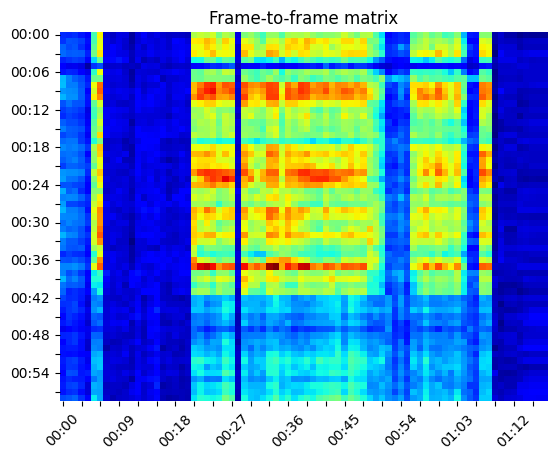

In [ ]:
sim_matrix = model.calculate_f2f_matrix(query_features[None, :], target_features[None, :])
if device.type == 'cuda':
  sim_matrix = sim_matrix.detach().to('cpu')
visualize_matrix(sim_matrix[0], 'Frame-to-frame matrix')

[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 78, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 9, 9, 78])
[f2f] cs shape: torch.Size([1, 59, 78])


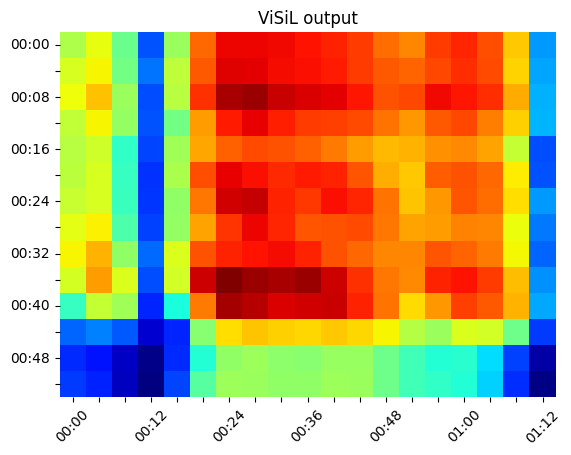

In [ ]:
sim_matrix = model.calculate_visil_output(query_features[None, :], target_features[None, :])
if device.type == 'cuda':
  sim_matrix = sim_matrix.detach().to('cpu')
visualize_matrix(sim_matrix[0], 'ViSiL output', step=4)

## Plot Features (in lower-dimensional space)

### Two similar videos

In [ ]:
# Not working properly: non-deterministic behavior.
def reduce_dimension(X, dim=2):
  # Center points
  X_mean = torch.mean(X, axis=0, keepdim=True)
  X_centered = X - X_mean
  # print('X mean shape: ', X_mean.shape)

  # Compute SVD
  q = min(X.shape)
  U, S, V = torch.pca_lowrank(X_centered, q=q, center=False, niter=10)
  print('X shape: ', X.shape)
  print('U shape: ', U.shape)
  print('S shape: ', S.shape)
  print('V shape: ', V.shape)
  print('S: ', S)

  # Project the data onto principal components
  X_transformed = torch.matmul(X, V[:, :dim])
  # print('X transformed shape: ', X_transformed.shape)
  # X_transformed += torch.matmul(X_mean, V[:, :dim])
  # print('X mean transformed shape: ', torch.matmul(X_mean, V[:, :dim]).shape)

  return X_transformed

In [17]:
# See reference here: https://stackoverflow.com/questions/55263552/sklearn-pca-how-to-restore-mean-in-lower-dimension
from sklearn.decomposition import PCA

def reduce_dimension(X, dim=2):
  X = X.cpu() if device.type == 'cuda' else X
  X = X.detach().numpy() if type(X) == torch.Tensor else X

  pca = PCA(dim)
  pca.fit(X)
  X_transformed = pca.transform(X) #+ pca.fit_transform(pca.mean_[None, :])
  X_original = pca.inverse_transform(X_transformed)

  return torch.from_numpy(X_original)

In [ ]:
# =========================
#     test case of PCA
# =========================
from sklearn import datasets
# Principal Component Analysis
from numpy import array
from sklearn.decomposition import PCA

X, y = datasets.make_blobs(n_samples=150,
                           n_features=5,
                           centers=1,
                           cluster_std=1.05,
                           random_state=2)

print(f'dataset shape: {X.shape}, {y.shape}')
print(f'X mean: {X.mean(axis=0)}')

# -----------------------------
# method 1
# -----------------------------
# create the PCA instance
pca = PCA(2)
# fit on data
pca.fit(X)
# access values and vectors
print(pca.components_)
print(pca.explained_variance_)
# transform data
X_transformed = pca.transform(X) #+ pca.fit_transform(pca.mean_[None, :])
X_original = pca.inverse_transform(X_transformed)
print(f'X_transformed shape: {X_transformed.shape}')
print(f'X_transformed mean: {X_transformed.mean(axis=0)}')

# -----------------------------
# method 2
# -----------------------------
X_transformed_1 = reduce_dimension(torch.tensor(X), 2)

fig = plt.figure()
ax = fig.add_subplot(3, 1, 1)
plt.scatter(X[:, 0], X[:, 1], marker='o', c=y)
ax = fig.add_subplot(3, 1, 2)
plt.scatter(X_transformed[:, 0], X_transformed[:, 1], marker='o', c=y)
ax = fig.add_subplot(3, 1, 3)
plt.scatter(X_original[:, 0], X_original[:, 1], marker='o', c=y)
plt.show()

In [299]:
feature_path = '%s/visil/features' % GIT_REPO_PATH
query_video_id = video_ids[0]
target_video_id = video_ids[3]

query_features = torch.load('%s/%s.pt' % (feature_path, query_video_id), map_location=device)
target_features = torch.load('%s/%s.pt' % (feature_path, target_video_id), map_location=device)

In [300]:
display_videos([query_video_id, target_video_id])

In [ ]:
query_features_flat = query_features.view(-1, 9*3840)
target_features_flat = target_features.view(-1, 9*3840)
query_features_flat.shape, target_features_flat.shape

(torch.Size([59, 34560]), torch.Size([60, 34560]))

In [ ]:
query_features_redu = reduce_dimension(query_features_flat, 2)
target_features_redu = reduce_dimension(target_features_flat, 2)
query_features_redu.shape, target_features_redu.shape

((59, 34560), (60, 34560))

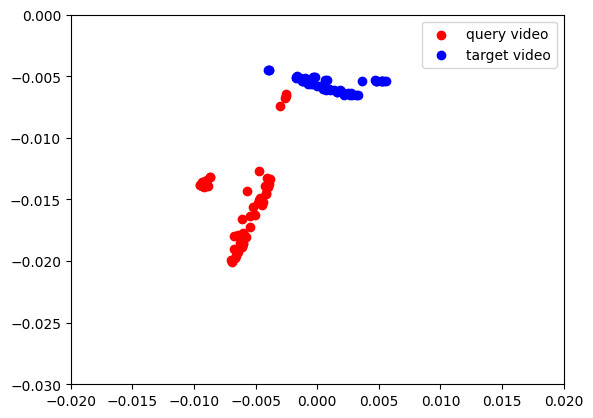

In [ ]:
# 2D plot
plt.scatter(query_features_redu[:, 0], query_features_redu[:, 1], c='r', marker='o')
plt.scatter(target_features_redu[:, 0], target_features_redu[:, 1], c='b', marker='o')

plt.xlim(-0.02, 0.02)
plt.ylim(-0.03, 0.0)
ax = plt.gca()
ax.set_aspect('equal', adjustable='box')
ax.legend(['query video', 'target video'])
plt.show()

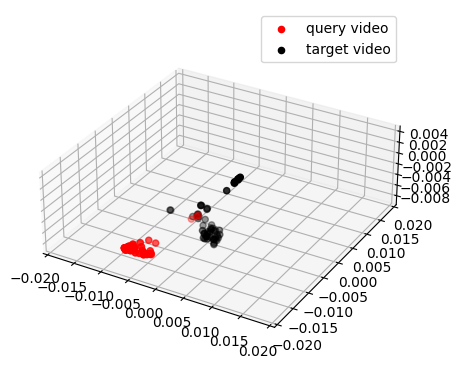

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

x = query_features_redu[:, 0]
y = query_features_redu[:, 1]
z = query_features_redu[:, 2]

ax.scatter(x, y, z, c='r', marker='o')

x = target_features_redu[:, 0]
y = target_features_redu[:, 1]
z = target_features_redu[:, 2]

ax.scatter(x, y, z, c='k', marker='o')

plt.xlim(-0.02, 0.02)
plt.ylim(-0.02, 0.02)
ax = plt.gca()
ax.set_aspect('equal', adjustable='box')
ax.legend(['query video', 'target video'])
plt.show()

### Two disimilar videos

In [294]:
feature_path = '%s/visil/features' % GIT_REPO_PATH
query_video_id = video_ids[5]
target_video_id = video_ids[10]

query_features = torch.load('%s/%s.pt' % (feature_path, query_video_id), map_location=device)
target_features = torch.load('%s/%s.pt' % (feature_path, target_video_id), map_location=device)

In [295]:
display_videos([query_video_id, target_video_id])

In [ ]:
query_features_flat = query_features.view(-1, 9*3840)
target_features_flat = target_features.view(-1, 9*3840)
query_features_flat.shape, target_features_flat.shape

(torch.Size([37, 34560]), torch.Size([60, 34560]))

In [ ]:
dim = 3
query_features_redu = reduce_dimension(query_features_flat, dim)#.view(-1, 9, dim).view(-1, 9*dim)
target_features_redu = reduce_dimension(target_features_flat, dim)#.view(-1, 9, dim).view(-1, 9*dim)
query_features_redu.shape, target_features_redu.shape

((37, 34560), (60, 34560))

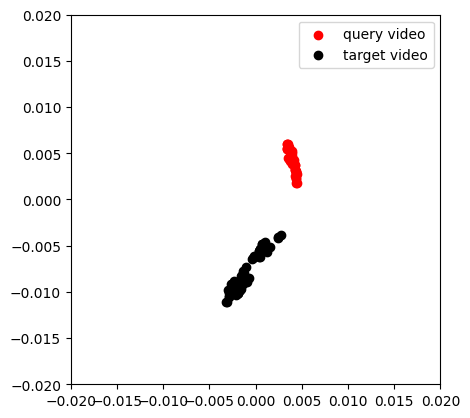

In [ ]:
# 2D plot
plt.scatter(query_features_redu[:, 0], query_features_redu[:, 1], c='r', marker='o')
plt.scatter(target_features_redu[:, 0], target_features_redu[:, 1], c='k', marker='o')

plt.xlim(-0.02, 0.02)
plt.ylim(-0.02, 0.02)
ax = plt.gca()
ax.set_aspect('equal', adjustable='box')
ax.legend(['query video', 'target video'])
plt.show()

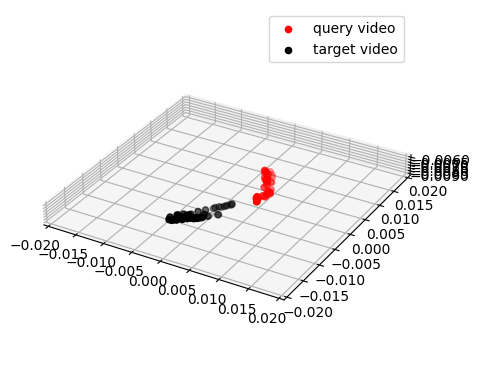

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

x = query_features_redu[:, 0]
y = query_features_redu[:, 1]
z = query_features_redu[:, 2]

ax.scatter(x, y, z, c='r', marker='o')

x = target_features_redu[:, 0]
y = target_features_redu[:, 1]
z = target_features_redu[:, 2]

ax.scatter(x, y, z, c='k', marker='o')

plt.xlim(-0.02, 0.02)
plt.ylim(-0.02, 0.02)
ax = plt.gca()
ax.set_aspect('equal', adjustable='box')
ax.legend(['query video', 'target video'])
plt.show()

In [ ]:
similarity = model.calculate_video_similarity(query_features, target_features)
similarity.detach().to('cpu')

[f2f] query shape: torch.Size([1, 37, 9, 3840])
[f2f] target shape: torch.Size([1, 60, 9, 3840])
[f2f] sim shape: torch.Size([1, 37, 9, 9, 60])
[f2f] cs shape: torch.Size([1, 37, 60])
[v2v] f2f sim shape: torch.Size([1, 37, 60])
[visil] sim shape: torch.Size([1, 1, 37, 60])
[visil] out shape: torch.Size([1, 9, 15])
[v2v] visil shape: torch.Size([1, 9, 15])
[v2v] tanh shape: torch.Size([1, 9, 15])
[v2v] cs shape: torch.Size([1])


tensor([-0.9828])

## Filtering and Ranking

In the section, we will build a small yet fully functional media match system, which consists of the following components.

- Extract features for each frame given a video, and store it in DB
- Find all matched videos given a query videos, ranked by similarity score

In [ ]:
# Extract features for all videos and save them in file.
feature_path = '%s/visil/features' % GIT_REPO_PATH
if not os.path.exists(feature_path):
  !mkdir -p $feature_path

for video_id in video_ids:
  feature_file = '%s/%s.pt' % (feature_path, video_id)
  if os.path.exists(feature_file):
    continue
  video = torch.from_numpy(load_video(video_name(video_id)))
  if device == 'cuda':
    features = model.extract_features(video.to('cuda'))
  else:
    features = model.extract_features(video)

  torch.save(features, feature_file)

fps: 30.0, total number of frames: 1099.0,
          duration in seconds: 36.0
[cnn] layer name:conv1, in dim: torch.Size([37, 3, 224, 224]), out dim: torch.Size([37, 64, 112, 112])
[cnn] layer name:bn1, in dim: torch.Size([37, 64, 112, 112]), out dim: torch.Size([37, 64, 112, 112])
[cnn] layer name:relu, in dim: torch.Size([37, 64, 112, 112]), out dim: torch.Size([37, 64, 112, 112])
[cnn] layer name:maxpool, in dim: torch.Size([37, 64, 112, 112]), out dim: torch.Size([37, 64, 56, 56])
[cnn] layer name:layer1, in dim: torch.Size([37, 64, 56, 56]), out dim: torch.Size([37, 256, 56, 56])
[region pooling], layer name: layer1, in shape: torch.Size([37, 256, 56, 56]), out shape: torch.Size([37, 256, 3, 3]), s: 28
[region norm], layer name: layer1, in shape: torch.Size([37, 256, 3, 3]), out shape: torch.Size([37, 256, 3, 3])
[cnn] layer name:layer2, in dim: torch.Size([37, 256, 56, 56]), out dim: torch.Size([37, 512, 28, 28])
[region pooling], layer name: layer2, in shape: torch.Size([37, 51

In [12]:
# Load all features in a map (video id => features).
feature_path = '%s/visil/features' % GIT_REPO_PATH
feature_map = {}
for video_id in video_ids:
  feature_file = '%s/%s.pt' % (feature_path, video_id)
  feature_map[video_id] = torch.load(feature_file, map_location=device)
len(feature_map)

25

### Direct method

In [ ]:
import numpy as np

num_videos = len(video_ids)
similarity_matrix = np.zeros((num_videos, num_videos))

for i in range(num_videos):
  video_id_i = video_ids[i]
  for j in range(i, num_videos):
    video_id_j = video_ids[j]
    similarity_matrix[i][j] = model.calculate_video_similarity(feature_map[video_id_i].to('cuda'), feature_map[video_id_j].to('cuda'))

[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 59, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 9, 9, 59])
[f2f] cs shape: torch.Size([1, 59, 59])
[v2v] f2f sim shape: torch.Size([1, 59, 59])
[visil] sim shape: torch.Size([1, 1, 59, 59])
[visil] out shape: torch.Size([1, 14, 14])
[v2v] visil shape: torch.Size([1, 14, 14])
[v2v] tanh shape: torch.Size([1, 14, 14])
[v2v] cs shape: torch.Size([1])
[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 38, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 9, 9, 38])
[f2f] cs shape: torch.Size([1, 59, 38])
[v2v] f2f sim shape: torch.Size([1, 59, 38])
[visil] sim shape: torch.Size([1, 1, 59, 38])
[visil] out shape: torch.Size([1, 14, 9])
[v2v] visil shape: torch.Size([1, 14, 9])
[v2v] tanh shape: torch.Size([1, 14, 9])
[v2v] cs shape: torch.Size([1])
[f2f] query shape: torch.Size([1, 59, 9, 3840])
[f2f] target shape: torch.Size([1, 60, 9, 3840])
[f2f] sim shape: torch.Size([1, 59, 

In [ ]:
import pandas as pd

df = pd.DataFrame(similarity_matrix)
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,0.939858,0.741221,-0.958313,0.537412,0.758091,-0.982299,-0.972205,-0.982255,-0.927155,-0.982274,-0.635007,-0.693313,-0.661182,-0.814077,-0.622124,-0.353346,-0.548006,-0.644638,-0.615507,-0.782474,-0.913282,-0.826203,-0.874914,-0.667296,-0.374572
1,0.000000,0.956019,-0.984438,0.539910,0.956889,-0.984493,-0.976957,-0.984549,-0.972760,-0.961640,-0.638739,-0.671294,-0.710458,-0.849038,-0.684053,-0.370401,-0.614786,-0.782088,-0.860601,-0.912223,-0.873026,-0.823436,-0.878606,-0.817402,-0.429891
2,0.000000,0.000000,0.910742,-0.952764,-0.984721,-0.984474,-0.984956,-0.984886,-0.966054,-0.985870,-0.986968,-0.987250,-0.982592,-0.984988,-0.988665,-0.989081,-0.987630,-0.986975,-0.990123,-0.986234,-0.980639,-0.978401,-0.982645,-0.981833,-0.986170
3,0.000000,0.000000,0.000000,0.924430,0.501032,-0.984168,-0.974295,-0.975814,-0.948585,-0.964267,-0.887702,-0.927769,-0.815924,-0.898514,-0.808203,-0.185733,-0.346643,-0.591020,-0.715310,-0.594728,-0.835458,-0.786058,-0.860666,-0.524306,-0.465592
4,0.000000,0.000000,0.000000,0.000000,0.948755,-0.985102,-0.979155,-0.982663,-0.982141,-0.978779,-0.643245,-0.672903,-0.616214,-0.787046,-0.684330,-0.391097,-0.622648,-0.677341,-0.694506,-0.806456,-0.924214,-0.844294,-0.879470,-0.676763,-0.444114
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.954607,0.969230,0.951872,-0.217382,0.167537,-0.982793,-0.983012,-0.983290,-0.981847,-0.986978,-0.988905,-0.989084,-0.986593,-0.930392,-0.989029,-0.989073,-0.948871,-0.918914,-0.788621,-0.906224
6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.957214,0.916511,-0.030523,0.102961,-0.964608,-0.965634,-0.973492,-0.963704,-0.986840,-0.988531,-0.989823,-0.984036,-0.943024,-0.988060,-0.989739,-0.965625,-0.959532,-0.762657,-0.846075
7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.925892,-0.240537,0.106699,-0.960781,-0.939271,-0.972646,-0.963050,-0.983888,-0.989272,-0.990113,-0.978356,-0.955432,-0.987836,-0.984781,-0.969634,-0.940794,-0.865300,-0.904405
8,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.881508,-0.076390,-0.978773,-0.964261,-0.877983,-0.950290,-0.823618,-0.917933,-0.931907,-0.955085,-0.977104,-0.906131,-0.982564,-0.982144,-0.967115,-0.887702,-0.838755
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.929251,-0.981761,-0.980751,-0.979554,-0.986656,-0.917257,-0.988909,-0.989434,-0.987530,-0.912365,-0.983894,-0.982263,-0.963754,-0.978523,-0.947346,-0.963504


### Hierarchical method

In [10]:
import hashlib

M = 16
def to_str(t):
  return ''.join([str(e) for e in t[:M]])

def hash_tensor_1d(idx, vec):
  return hashlib.sha256((str(idx) + to_str(vec)).encode()).hexdigest()

In [19]:
DIM = 29 # Can't use a larger number, investigate why.
num_videos = len(video_ids)
feat2vid = {} # frame feature SHA => video id
vid2feat = {} # video id => frame features
all_features = []
all_frames = [] # frame info: (video id, frame idx)

for i in range(num_videos):
  video_id = video_ids[i]
  features = feature_map[video_id].view(-1, 9*3840)

  # Dimension reduction using PCA
  features_redu = reduce_dimension(features, DIM) # num_frames x DIM

  vid2feat[video_id] = features_redu
  all_features.append(features_redu)
  all_frames.extend([(video_id, frame_idx) for frame_idx in range(features.shape[0])])

  f2v = {hash_tensor_1d(idx, f) : video_ids[i] for idx, f in enumerate(features_redu)}
  assert len(f2v) == features_redu.shape[0], f"{video_ids[i]}: {len(f2v)}, {features_redu.shape[0]}"
  feat2vid.update(f2v)

all_features = torch.cat(all_features, 0)
print('num of frame hashes: %d, num of frame features %d' % (len(feat2vid), all_features.shape[0]))

num of frame hashes: 1245, num of frame features 1245


In [20]:
def calc_pairwise_dist(features1, features2):
  N, D = features1.shape
  T, _ = features2.shape
  assert features1.dtype == features2.dtype
  dtype = features1.dtype
  return torch.matmul(features1**2, torch.ones((D, T), dtype=dtype)) + torch.matmul(torch.ones((N, D), dtype=dtype), torch.t(features2**2)) - 2 * torch.matmul(features1, torch.t(features2))

# a = torch.tensor([[1, 1, 1], [2, 2, 2], [3, 3, 3], [4, 4, 4]], dtype=int)
# b = torch.tensor([[0, 1, 2], [3, 4, 5], [6, 7, 8], [9, 10, 11]], dtype=int)
# calc_pairwise_dist(a, b)

In [ ]:
def calc_cosine_similarity(features1, features2):
  N, D = features1.shape
  T, _ = features2.shape
  assert features1.dtype == features2.dtype
  dtype = features1.dtype
  similarity_matrix = torch.zeros((N, T))
  for i in range(N):
    for j in range(T):
      similarity_matrix[i][j] = torch.dot(features1[i], features2[j])

  return similarity_matrix

# a = torch.tensor([[1, 1, 1], [2, 2, 2], [3, 3, 3], [4, 4, 4]], dtype=int)
# b = torch.tensor([[0, 1, 2], [3, 4, 5], [6, 7, 8], [9, 10, 11]], dtype=int)
# calc_cosine_similarity(a, b)

In [21]:
import pandas as pd

query_video_id = video_ids[10]
features = vid2feat[query_video_id]

dist_matrix = calc_pairwise_dist(features.cpu(), all_features.cpu().float())
sorted_dist_matrix, indices = torch.sort(dist_matrix, dim = 1, descending=False) # Ascending order

df = pd.DataFrame(sorted_dist_matrix[:10, 0:120].detach().numpy())
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119
0,0.000000,1.726229,1.845042,1.888422,2.028486,2.072264,2.076840,2.152897,2.183267,2.260526,2.326756,2.372235,2.374830,2.396641,2.406586,2.406808,2.425999,2.433125,2.589348,2.616476,2.616700,2.650645,2.660829,2.661435,2.662016,2.671210,2.674448,2.686852,2.687671,2.689414,2.691903,2.705685,2.725950,2.735830,2.738436,2.770344,2.777210,2.789329,2.791547,2.799597,2.804669,2.816262,2.874008,2.874795,2.883024,2.885564,2.885632,2.891038,2.894574,2.895495,2.897099,2.912369,2.917522,2.918621,2.921051,2.921732,2.931379,2.944350,2.953407,2.953908,2.954139,2.955292,2.961388,2.973420,2.974294,2.980283,2.982599,2.982851,2.990321,2.991542,2.994252,2.994420,2.998876,3.004947,3.005866,3.007200,3.009891,3.011085,3.012829,3.015438,3.017532,3.017555,3.019183,3.020024,3.022027,3.026109,3.028757,3.029703,3.030869,3.032540,3.038439,3.041251,3.041441,3.042185,3.045195,3.048324,3.050740,3.052408,3.055795,3.059066,3.059663,3.060596,3.063217,3.065315,3.065955,3.066066,3.066120,3.069404,3.073858,3.078749,3.081286,3.082293,3.083436,3.084033,3.086987,3.088310,3.089803,3.090157,3.092132,3.092738
1,0.000000,0.397652,1.462139,1.484884,1.726229,1.765443,1.812803,1.920646,1.937233,1.956714,2.030712,2.042007,2.061133,2.061601,2.205930,2.226006,2.325837,2.338365,2.380017,2.389912,2.400638,2.407991,2.432345,2.432971,2.441123,2.463203,2.467780,2.474212,2.479825,2.480357,2.491576,2.501274,2.507886,2.530354,2.542645,2.556624,2.558022,2.560481,2.567851,2.569418,2.574554,2.581683,2.584948,2.585818,2.598463,2.603190,2.607778,2.629606,2.632631,2.637270,2.649579,2.650517,2.650653,2.653627,2.657145,2.663264,2.668647,2.675232,2.687101,2.696264,2.709344,2.710478,2.710990,2.712461,2.719736,2.724993,2.728035,2.729932,2.731698,2.734568,2.740772,2.741537,2.742876,2.744488,2.745617,2.747577,2.751252,2.753875,2.755277,2.755383,2.756768,2.758844,2.760597,2.761528,2.764555,2.764645,2.764939,2.770283,2.774897,2.777726,2.778652,2.779745,2.783270,2.786042,2.788182,2.790859,2.791712,2.795189,2.802886,2.806119,2.807193,2.811872,2.812926,2.814030,2.816284,2.816697,2.820115,2.821265,2.824777,2.825015,2.826507,2.835312,2.835494,2.837562,2.837735,2.840156,2.842421,2.846004,2.849195,2.849741
2,0.000000,0.397652,1.342784,1.438290,1.443590,1.472883,1.708535,1.717451,1.788955,1.795131,1.974912,1.986876,2.053103,2.080577,2.118719,2.163301,2.166568,2.270490,2.283772,2.321753,2.322700,2.338892,2.350062,2.353916,2.362326,2.363438,2.372235,2.397926,2.405040,2.416270,2.423041,2.436183,2.449591,2.451234,2.457030,2.471405,2.489317,2.492701,2.524254,2.532446,2.532500,2.537207,2.545371,2.549980,2.563854,2.567325,2.573678,2.580245,2.603662,2.605015,2.605352,2.616110,2.618035,2.626749,2.630567,2.638157,2.647028,2.658440,2.659051,2.664144,2.666923,2.668848,2.671681,2.683572,2.690586,2.691422,2.693211,2.698911,2.700914,2.701033,2.703025,2.704607,2.705721,2.709788,2.710402,2.717232,2.719129,2.719525,2.719791,2.721608,2.723519,2.724977,2.726051,2.728271,2.728759,2.729073,2.730485,2.730813,2.731751,2.732363,2.735783,2.735909,2.740733,2.742786,2.744111,2.746820,2.747240,2.748175,2.750250,2.750503,2.759339,2.762421,2.764537,2.765907,2.768788,2.771264,2.772014,2.775196,2.777285,2.778137,2.778395,2.782429,2.782703,2.787383,2.788678,2.788828,2.792737,2.798543,2.803108,2.804637
3,-0.000000,0.215986,1.285944,1.295562,1.304854,1.364152,1.438290,1.795849,1.812803,1.912409,1.919004,1.940670,2.013528,2.025483,2.046811,2.078244,2.097803,2.131340,2.182911,2.243251,2.252591,2.260526,2.294823,2.297781,2.306441,2.326247,2.348248,2.349579,2.354363,2.377821,2.405262,2.409893,2.416052,2.419816,2.424956,2.426401,2.455286,2.457350,2.463459,2.470758,2.484310,2.492092,2.

In [22]:
df = pd.DataFrame(indices[:10, 0:120].detach().numpy())
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119
0,503,504,514,512,563,570,508,509,564,506,507,505,567,571,543,565,566,572,591,651,513,648,568,595,573,652,601,656,550,556,655,516,654,1125,546,1143,553,649,529,519,538,525,547,511,653,676,526,650,528,657,1192,587,549,675,1208,575,532,531,551,611,604,689,582,535,1205,1167,602,594,718,598,669,631,599,600,380,1209,1227,523,581,603,1190,555,1237,554,596,1170,1242,515,661,585,670,597,673,1173,382,717,660,560,1211,552,1210,527,1171,1226,562,558,616,569,1193,858,387,465,662,383,542,685,633,236,808,1188
1,504,505,563,564,503,507,506,513,565,567,514,570,508,566,512,648,510,568,572,652,655,591,571,509,1125,649,546,595,1143,651,573,529,538,601,527,656,549,517,650,548,676,1192,647,535,1208,675,556,547,654,533,560,653,631,1205,550,689,599,1209,582,1190,598,1167,541,519,587,611,594,526,1210,575,382,1211,669,1227,528,1237,1170,1193,1188,551,380,523,543,600,718,1242,657,1173,666,383,387,1226,554,670,531,557,581,1171,364,685,562,633,604,632,1191,388,596,579,701,597,1239,386,1236,227,624,465,717,858,616,808
2,505,504,507,506,564,563,565,513,567,566,508,570,510,648,568,514,509,652,518,649,527,655,591,571,651,572,503,595,529,1125,573,512,517,515,1143,650,601,653,647,654,523,656,676,538,575,1192,546,1208,675,582,551,553,1205,631,689,535,549,552,669,1209,550,544,526,594,382,1190,602,599,545,1167,531,603,548,598,718,1237,611,380,1227,666,670,383,1170,554,1210,581,1242,387,528,556,1188,1193,1211,587,596,543,604,1226,1173,600,364,657,560,569,633,1171,685,597,632,388,616,386,668,661,717,1239,547,701,511,1191
3,506,507,509,566,565,508,505,567,504,564,563,648,570,514,649,513,568,651,591,538,595,503,572,516,571,652,650,1125,512,1143,573,526,655,553,601,517,676,535,544,529,1192,546,575,530,1208,654,594,669,656,1205,631,569,653,556,551,562,545,582,554,527,611,689,670,598,604,550,380,1170,382,1237,581,1190,596,675,1167,1227,560,542,600,1173,718,1209,597,383,552,603,387,602,673,548,616,1171,515,549,523,1242,1193,633,632,1226,1210,525,1211,599,364,518,1188,660,386,587,661,533,1239,717,547,574,511,668,388,685
4,507,506,509,508,566,565,505,567,504,570,648,563,568,564,514,649,651,511,513,512,652,591,572,571,526,650,538,1125,1143,517,595,569,527,655,573,601,654,529,676,1192,1208,503,653,656,546,1205,575,669,549,535,594,582,631,548,581,556,689,560,542,562,553,670,516,518,550,380,382,1209,611,598,1190,1167,1170,675,1237,1227,600,718,383,387,530,1173,1193,547,1210,551,633,673,1211,1171,604,1242,1188,364,685,599,525,1226,632,554,616,544,668,386,660,661,537,540,557,717,465,1239,388,236,379,597,552,385,587,1236
5,508,509,507,506,567,566,568,512,565,570,514,651,563,564,505,510,513,504,571,572,503,652,650,648,649,518,538,517,591,656,655,529,1125,546,1143,654,527,573,595,575,543,1208,653,676,526,1205,601,547,549,550,1192,528,582,569,1209,675,541,519,598,556,581,669,631,657,562,689,560,660,1167,633,382,380,1237,611,523,587,548,1210,594,1227,1190,718,1170,632,599,600,383,661,387,1242,597,673,1173,574,670,551,364,1211,553,596,685,1171,668,465,1226,1193,1188,388,386,579,717,1239,604,379,373,616,544,603,554,858
6,509,508,507,512,567,506,566,568,514,570,565,510,513,651,571,572,652,563,564,650,648,649,503,505,656,518,655,654,591,538,517,1125,1143,595,527,573,526,653,569,511,575,529,546,504,676,1208,1205,601,553,543,657,1192,581,582,669,675,1209,631,594,689,587,556,633,550,380,611,1167,382,660,544,519,1237,598,718,673,632,549,562,1170,1227,1190,603,535,547,670,383,554,604,596,661,560,387,1242,597,1210,668,364,525,574,1173,528,552,685,465,523,600,1193,515,616,1171,1226,717,1211,551,379,1188,386,373,537,388
7,510,509,567,513,508,570,505,568,512,563,504,564,652,566,571,651,514,530,572,507,655,515,591,565,535,650,526,519

In [23]:
dist_thresh = 2.3
mask = sorted_dist_matrix < dist_thresh

df = pd.DataFrame(mask[:10, 0:120].detach().numpy())
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119
0,True,True,True,True,True,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,Tr

In [24]:
indices_tmp = indices.detach().clone()
indices_tmp[~mask] = -1

df = pd.DataFrame(indices_tmp[:10, 0:120].detach().numpy())
df.style.set_properties(**{'font-size':'6pt'}).background_gradient('Greys')

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119
0,503,504,514,512,563,570,508,509,564,506,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
1,504,505,563,564,503,507,506,513,565,567,514,570,508,566,512,648,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
2,505,504,507,506,564,563,565,513,567,566,508,570,510,648,568,514,509,652,518,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
3,506,507,509,566,565,508,505,567,504,564,563,648,570,514,649,513,568,651,591,538,595,503,572,516,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
4,507,506,509,508,566,565,505,567,504,570,648,563,568,564,514,649,651,511,513,512,652,591,572,571,526,650,538,1125,1143,517,595,569,527,655,573,601,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
5,508,509,507,506,567,566,568,512,565,570,514,651,563,564,505,510,513,504,571,572,503,652,650,648,649,518,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
6,509,508,507,512,567,506,566,568,514,570,565,510,513,651,571,572,652,563,564,650,648,649,503,505,656,518,655,654,591,538,517,1125,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
7,510,509,567,513,508,570,505,568,512,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
8,511,507,512,570,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1
9,512,514,513,570,509,571,572,508,567,568,503,656,563,511,566,654,651,507,655,573,652,657,517,504,591,565,510,564,538,546,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-

In [25]:
selected_indices = torch.masked_select(indices, mask)
len(selected_indices)

1858

In [26]:
matched_video_ids = []
for idx in selected_indices:
  feature = all_features[idx].detach()
  frame_idx = all_frames[idx][1]
  key = hash_tensor_1d(frame_idx, feature)
  matched_video_ids.append(feat2vid[key])

In [27]:
unq_matched_video_ids = []
for id in matched_video_ids:
  if id not in unq_matched_video_ids:
    unq_matched_video_ids.append(id)
unq_matched_video_ids, len(unq_matched_video_ids)

(['NtmNO8pgXnE',
  'HY0baJUyrLQ',
  'qX2AGo8-1KI',
  'ZMT7rIhETJM',
  'DE-2JFafshY',
  'JckyczBpYQY'],
 6)

In [30]:
from collections import OrderedDict

result = OrderedDict()
query_features = feature_map[query_video_id]
for video_id in unq_matched_video_ids:
  if video_id == query_video_id:
    continue
  target_features = feature_map[video_id]

  similarity = model.calculate_video_similarity(query_features, target_features)
  result[video_id] = similarity.detach().to('cpu').item()

result

[f2f] query shape: torch.Size([1, 60, 9, 3840])
[f2f] target shape: torch.Size([1, 55, 9, 3840])
[f2f] sim shape: torch.Size([1, 60, 9, 9, 55])
[f2f] cs shape: torch.Size([1, 60, 55])
[v2v] f2f sim shape: torch.Size([1, 60, 55])
[visil] sim shape: torch.Size([1, 1, 60, 55])
[visil] out shape: torch.Size([1, 15, 13])
[v2v] visil shape: torch.Size([1, 15, 13])
[v2v] tanh shape: torch.Size([1, 15, 13])
[v2v] cs shape: torch.Size([1])
[f2f] query shape: torch.Size([1, 60, 9, 3840])
[f2f] target shape: torch.Size([1, 60, 9, 3840])
[f2f] sim shape: torch.Size([1, 60, 9, 9, 60])
[f2f] cs shape: torch.Size([1, 60, 60])
[v2v] f2f sim shape: torch.Size([1, 60, 60])
[visil] sim shape: torch.Size([1, 1, 60, 60])
[visil] out shape: torch.Size([1, 15, 15])
[v2v] visil shape: torch.Size([1, 15, 15])
[v2v] tanh shape: torch.Size([1, 15, 15])
[v2v] cs shape: torch.Size([1])
[f2f] query shape: torch.Size([1, 60, 9, 3840])
[f2f] target shape: torch.Size([1, 60, 9, 3840])
[f2f] sim shape: torch.Size([1, 6

OrderedDict([('HY0baJUyrLQ', 0.9663383960723877),
             ('qX2AGo8-1KI', 0.6779883503913879),
             ('ZMT7rIhETJM', -0.6763649582862854),
             ('DE-2JFafshY', -0.03864441439509392),
             ('JckyczBpYQY', -0.7359575629234314)])

In [39]:
matched_video_ids = [key for key in result.keys()]
# display_videos(matched_video_ids)

video_urls = get_video_urls(matched_video_ids)
html_str = get_html_str(matched_video_ids, video_urls)
# display(HTML(html_str))

## Train Model

### Dataset
**anchor video**

**positive video**

- annotated: groundtruth annotation at segment level

- generated: apply random transformations (color, geometry, temporal)

**(hard) negative video**: construct negative videos (hard negatives) with similarity to the anchor that is greater than the one between the
anchor and positive videos. We use BoW as similarity measure.

At each training epoch, we sample $T$ triplets from each
video pool. Due to GPU memory limitations, we select
a random video snippet with total size of $W$ frames from
each video in the triplet, assuring that there are at least five
seconds overlap between the anchor and the positive videos.

**existing datasets**

[VCDB](https://fvl.fudan.edu.cn/dataset/vcdb/list.htm): used for video partial copy detection.

[CC WEB VIDEO](https://www.cs.cmu.edu/~wuxiao/Research/Webvideos.htm)

[FIVR-200K](https://ndd.iti.gr/fivr/)

[EVVE](https://openaccess.thecvf.com/content_cvpr_2013/papers/Revaud_Event_Retrieval_in_2013_CVPR_paper.pdf)

## Generate Dataset